In [ ]:
!pip show tensorflow

Name: tensorflow
Version: 2.15.0
Summary: TensorFlow is an open source machine learning framework for everyone.
Home-page: https://www.tensorflow.org/
Author: Google Inc.
Author-email: packages@tensorflow.org
License: Apache 2.0
Location: /usr/local/lib/python3.10/dist-packages
Requires: absl-py, astunparse, flatbuffers, gast, google-pasta, grpcio, h5py, keras, libclang, ml-dtypes, numpy, opt-einsum, packaging, protobuf, setuptools, six, tensorboard, tensorflow-estimator, tensorflow-io-gcs-filesystem, termcolor, typing-extensions, wrapt
Required-by: dopamine_rl, tensorflow-text, tf_keras


In [ ]:
# Library umum
import os
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import shutil
import random
import zipfile

# TensorFlow dan Keras
import tensorflow as tf
from tensorflow.keras.applications import InceptionV3
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Flatten, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from sklearn.model_selection import train_test_split
from tensorflow.keras.preprocessing import image_dataset_from_directory
import cv2  # OpenCV untuk membaca gambar

# Untuk mengakses Google Drive
from google.colab import drive

In [ ]:
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
with zipfile.ZipFile('/content/drive/My Drive/Capstone_C242-PS328/Dataset/Dataset_Gabungan/plant_house_species_2.zip', 'r') as zip_ref:
    zip_ref.extractall('/content/dataset')
print(os.listdir('/content/dataset'))

['plant_house_species_2']


# Eksplorasi Dataset

In [ ]:
# Direktori dataset
dataset_dir = '/content/dataset/plant_house_species_2'

In [ ]:
# Cek jumlah gambar per kelas jenis tanaman
# Daftar jumlah gambar per kelas
class_folders = os.listdir(dataset_dir)
class_counts = []
for class_name in class_folders:
    class_path = os.path.join(dataset_dir, class_name)
    if os.path.isdir(class_path):
        num_images = len(os.listdir(class_path))  # Menghitung jumlah gambar di dalam kelas
        class_counts.append((class_name, num_images))

# Menampilkan hasil
print("Class counts (Class Name, Number of Images):")
for class_name, num_images in class_counts:
    print(f"Class: {class_name}, Number of images: {num_images}")

Class counts (Class Name, Number of Images):
Class: Areca Palm (Dypsis lutescens), Number of images: 190
Class: Raspberry___healthy, Number of images: 1001
Class: Ponytail Palm (Beaucarnea recurvata), Number of images: 198
Class: Snake plant (Sanseviera), Number of images: 397
Class: Birds Nest Fern (Asplenium nidus), Number of images: 291
Class: Cherry___healthy, Number of images: 1001
Class: Elephant Ear (Alocasia spp.), Number of images: 333
Class: Dumb Cane (Dieffenbachia spp.), Number of images: 542
Class: Potato___healthy, Number of images: 1001
Class: Corn___healthy, Number of images: 1163
Class: Tomato___healthy, Number of images: 1592
Class: Apple___healthy, Number of images: 1646
Class: Strawberry___healthy, Number of images: 1001
Class: Pepper,_bell___healthy, Number of images: 1479
Class: Blueberry___healthy, Number of images: 1503
Class: Peach___healthy, Number of images: 1001
Class: Grape___healthy, Number of images: 1001
Class: Dracaena, Number of images: 262
Class: Polk

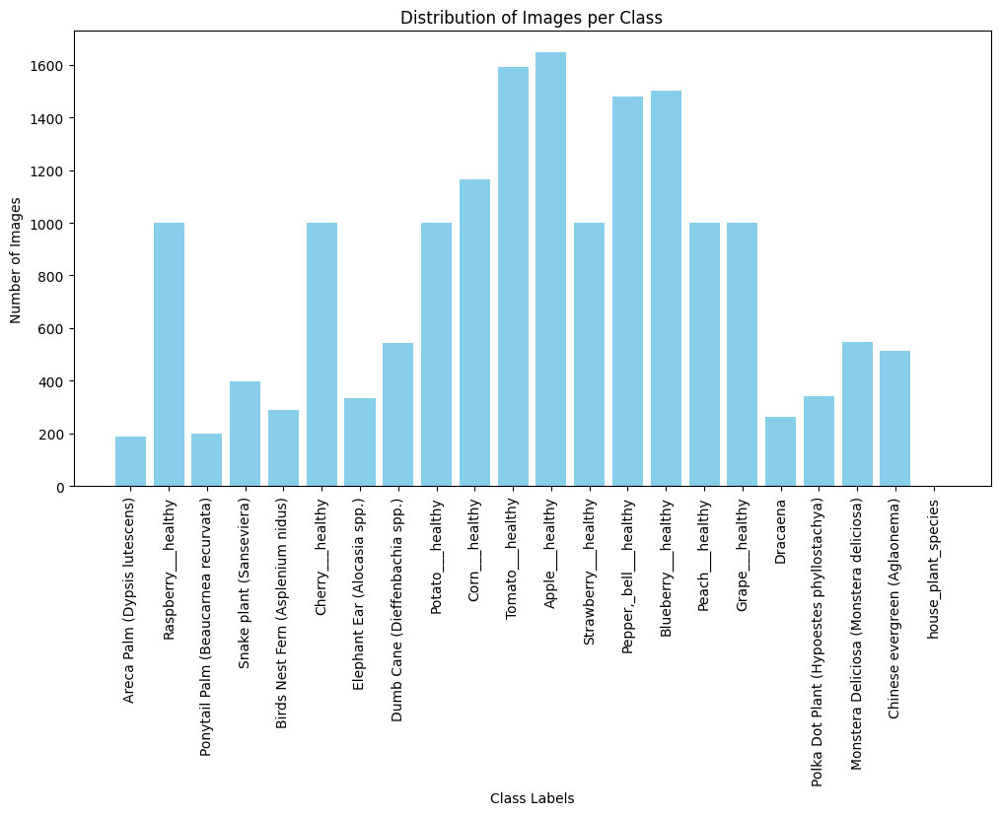

In [ ]:
# Memisahkan nama kelas dan jumlah gambar ke dua list terpisah
class_names = [item[0] for item in class_counts]
image_counts = [item[1] for item in class_counts]

# Membuat histogram distribusi jumlah gambar per kelas
plt.figure(figsize=(12, 6))
plt.bar(class_names, image_counts, color='skyblue')
plt.xlabel('Class Labels')
plt.ylabel('Number of Images')
plt.title('Distribution of Images per Class')
plt.xticks(rotation=90)
plt.show()

# Sample Gambar

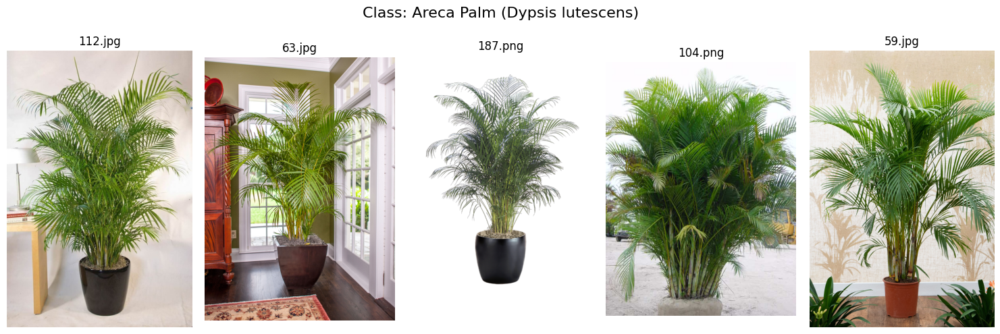

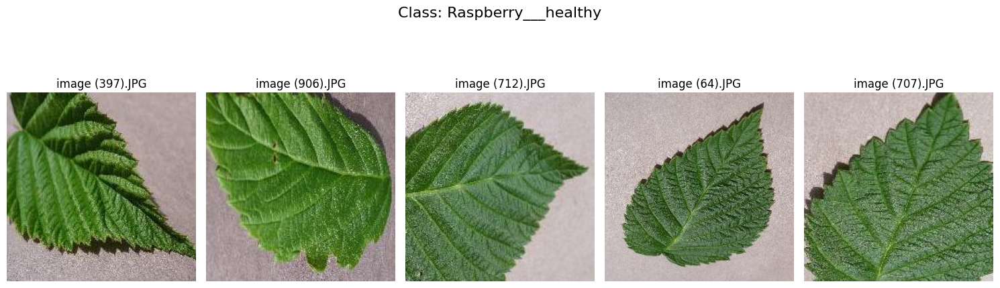

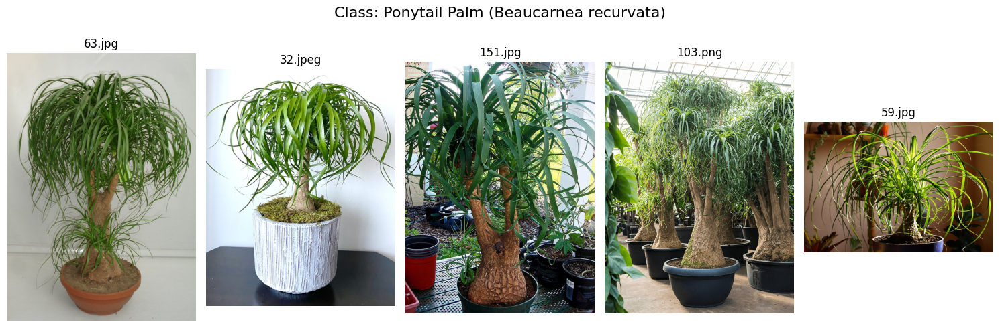

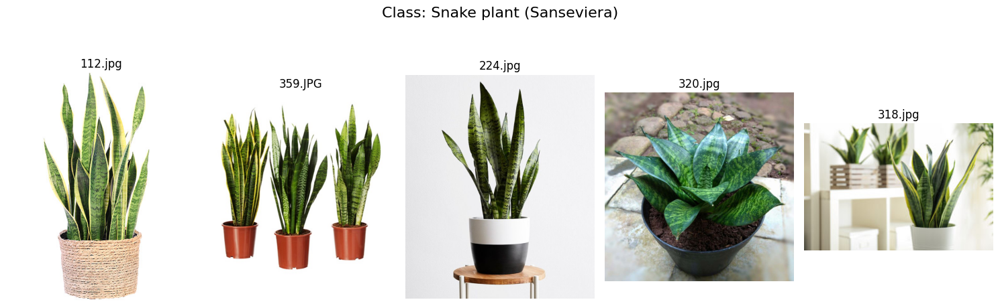

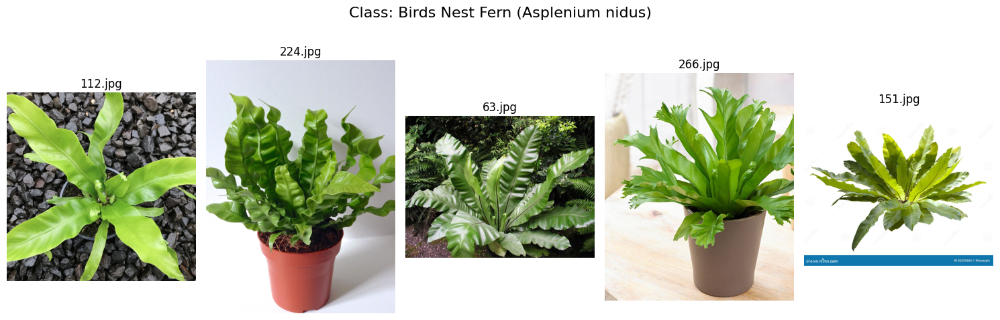

...

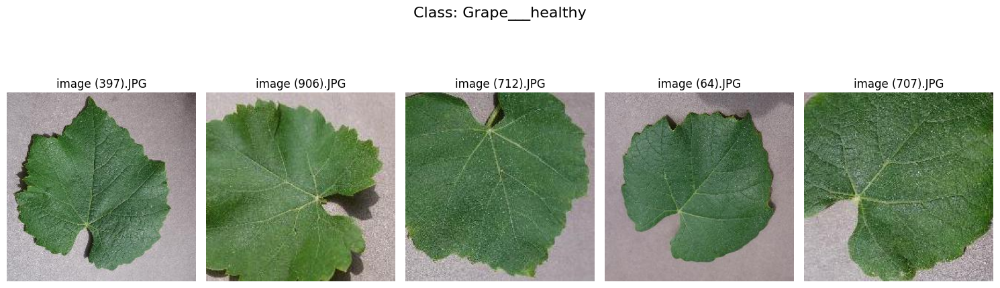

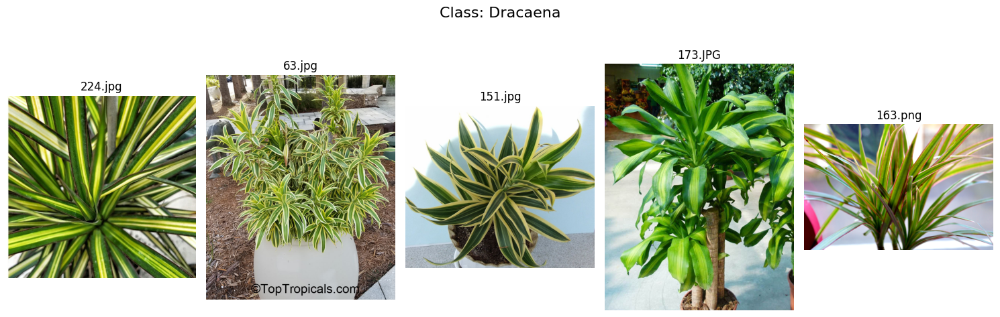

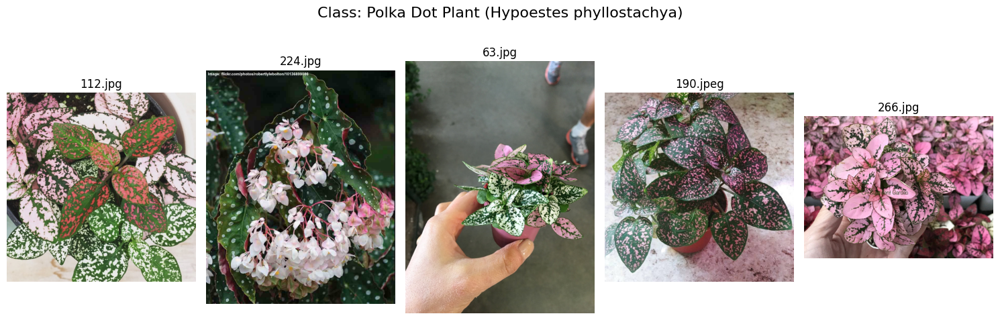

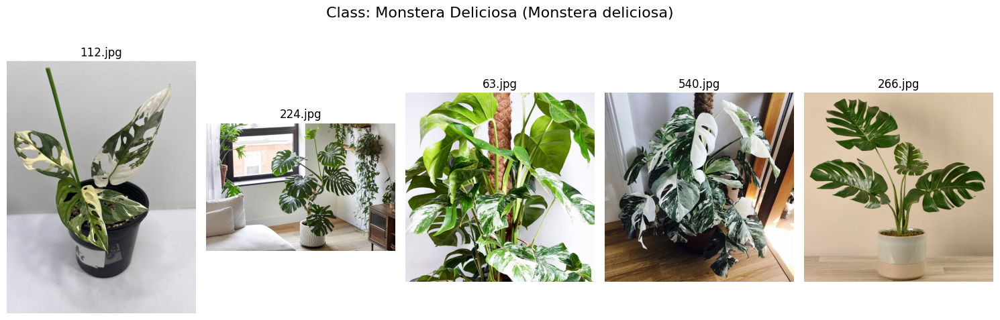

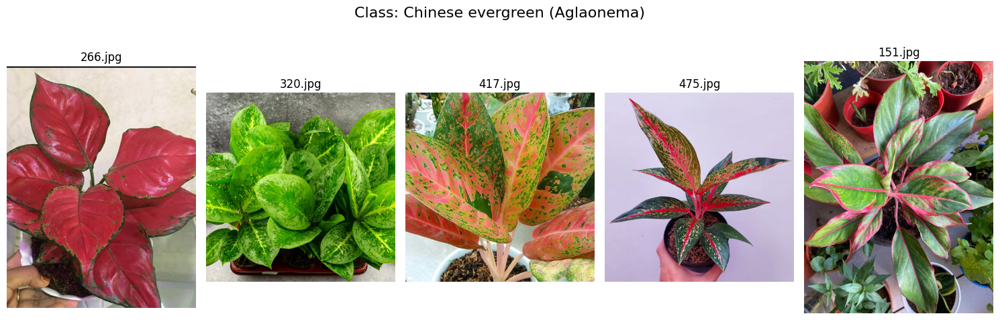

UnidentifiedImageError: cannot identify image file '/content/dataset/plant_house_species_2/house_plant_species/desktop.ini'

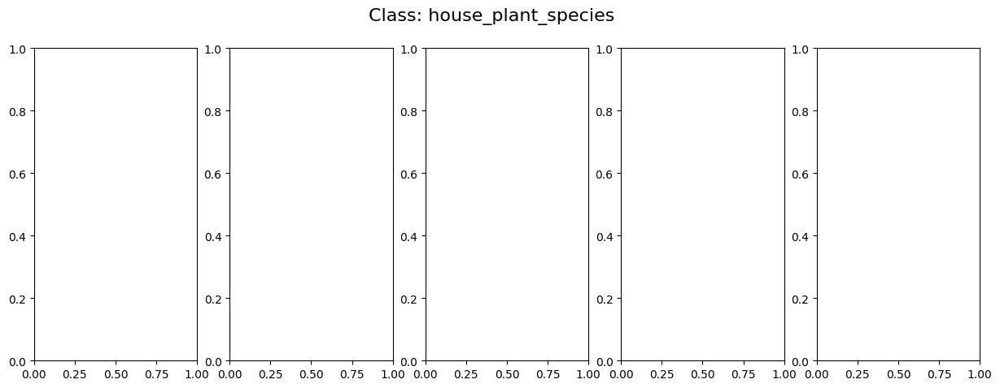

In [ ]:
# Jumlah gambar yang ingin diambil per kelas
num_samples = 5
# Ambil nama kelas
class_folders = os.listdir(dataset_dir)
# Menampilkan gambar dari setiap kelas
for class_name in class_folders:
    class_path = os.path.join(dataset_dir, class_name)
    # Pastikan folder kelas ada
    if os.path.isdir(class_path):
        # Ambil 5 gambar pertama dari kelas tersebut
        sample_images = os.listdir(class_path)[:num_samples]

        # Buat subplots untuk menampilkan gambar secara menyamping
        fig, axes = plt.subplots(1, num_samples, figsize=(15, 5))
        fig.suptitle(f"Class: {class_name}", fontsize=16)

        # Tampilkan gambar di setiap subplot
        for i, img_name in enumerate(sample_images):
            img_path = os.path.join(class_path, img_name)
            img = mpimg.imread(img_path)
            axes[i].imshow(img)
            axes[i].set_title(img_name)
            axes[i].axis('off')  # Menyembunyikan axis

        plt.tight_layout()
        plt.subplots_adjust(top=0.85)  # Memberikan ruang untuk judul utama
        plt.show()

# Menampilkan konsistensi Ukuran

In [ ]:
from PIL import Image
import os

# Direktori dataset
dataset_dir = '/content/dataset/Plant_leave_diseases_dataset_with_augmentation'

# Mengambil nama-nama kelas
class_folders = os.listdir(dataset_dir)

# Menyimpan ukuran gambar pertama untuk dibandingkan
first_image_size = None

# Loop melalui setiap kelas dan gambar untuk memeriksa ukurannya
consistent_size = True  # Asumsi awal bahwa ukuran gambar konsisten
sample_count = 0  # Counter untuk jumlah sampel yang sudah dicetak

for class_name in class_folders:
    class_path = os.path.join(dataset_dir, class_name)

    # Pastikan folder kelas ada
    if os.path.isdir(class_path):
        for img_name in os.listdir(class_path):
            img_path = os.path.join(class_path, img_name)

            # Pastikan hanya file gambar yang diproses
            if os.path.isfile(img_path):
                # Membuka gambar
                img = Image.open(img_path)

                # Ambil ukuran gambar
                img_size = img.size

                # Jika ini adalah gambar pertama, simpan ukurannya
                if first_image_size is None:
                    first_image_size = img_size
                # Jika ukuran gambar tidak sesuai dengan gambar pertama, beri tanda tidak konsisten
                elif img_size != first_image_size:
                    consistent_size = False
                    # Menampilkan hanya untuk 20 gambar pertama yang ukurannya berbeda
                    if sample_count < 20:
                        print(f"Image {img_name} has a different size: {img_size} (Expected: {first_image_size})")
                        sample_count += 1

# Menampilkan hasil konsistensi ukuran
if consistent_size:
    print("All images have the same size:", first_image_size)
else:
    print("Some images have different sizes.")


# Augmentasi

In [ ]:
# Augmentasi untuk training dan preprocessing untuk validasi
train_datagen = ImageDataGenerator(
    rescale=1.0 / 255,
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    validation_split=0.2  # Split 80% training, 20% validation
)

# Dataset training
train_dataset = train_datagen.flow_from_directory(
    dataset_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='sparse',  # Sparse integer labels
    subset='training'
)

# Dataset validasi
validation_dataset = train_datagen.flow_from_directory(
    dataset_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='sparse',  # Sparse integer labels
    subset='validation'
)

# Jumlah kelas
num_classes = len(train_dataset.class_indices)
print("Jumlah kelas:", num_classes)

# Menampilkan label dan indeks

In [ ]:
# Mendapatkan mapping class-indices
class_indices = train_dataset.class_indices

# Menampilkan label dan indeks
print("Mapping Label ke Indeks:")
for label, index in class_indices.items():
    print(f"Indeks: {index}, Label: {label}")


In [ ]:
# Membalik mapping agar indeks menjadi kunci
index_to_label = {index: label for label, index in class_indices.items()}

# Menampilkan label berdasarkan indeks (urut)
print("Label Berdasarkan Indeks:")
for index in range(len(index_to_label)):
    print(f"Indeks: {index}, Label: {index_to_label[index]}")


# Load Model Inception V3

In [ ]:
from tensorflow.keras.applications import InceptionV3
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model

# Load model InceptionV3 tanpa output layer
base_model = InceptionV3(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
base_model.trainable = False  # Freeze base model

# Tambahkan custom classifier
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(128, activation='relu')(x)
x = Dropout(0.5)(x)
predictions = Dense(num_classes, activation='softmax')(x)

# Buat model akhir
model = Model(inputs=base_model.input, outputs=predictions)

# Kompilasi model menggunakan sparse categorical crossentropy
model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001),
              loss='sparse_categorical_crossentropy',  # Sparse loss function
              metrics=['accuracy'])

# Lihat arsitektur model
model.summary()

# Training Model

In [ ]:
# Callback untuk menyimpan model terbaik berdasarkan akurasi validasi
checkpoint_cb = tf.keras.callbacks.ModelCheckpoint(
    "inceptionv3_best_model_sparse.h5",
    monitor="val_accuracy",
    save_best_only=True,
    verbose=1
)

# Train model
history = model.fit(
    train_dataset,
    validation_data=validation_dataset,
    epochs=20,  # Jumlah epoch
    callbacks=[checkpoint_cb]
)

# Evaluasi Model

In [ ]:
# Load model terbaik
best_model = tf.keras.models.load_model("inceptionv3_best_model_sparse.h5")

# Evaluasi pada data validasi
val_loss, val_accuracy = best_model.evaluate(validation_dataset)
print(f"Akurasi Validasi: {val_accuracy * 100:.2f}%")


# Visualisasi Hasil Training

In [ ]:
# Plot loss dan akurasi
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(len(acc))

plt.figure(figsize=(12, 4))

# Plot Akurasi
plt.subplot(1, 2, 1)
plt.plot(epochs, acc, 'b', label='Training accuracy')
plt.plot(epochs, val_acc, 'r', label='Validation accuracy')
plt.title('Training and Validation Accuracy')
plt.legend()

# Plot Loss
plt.subplot(1, 2, 2)
plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.title('Training and Validation Loss')
plt.legend()

plt.show()

# Prediksi Gambar

In [ ]:
from tensorflow.keras.preprocessing import image
import numpy as np

def predict_image(img_path, model, class_indices):
    # Preprocess gambar
    img = image.load_img(img_path, target_size=(224, 224))
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0) / 255.0

    # Prediksi
    predictions = model.predict(img_array)
    predicted_class_index = np.argmax(predictions)
    predicted_class = list(class_indices.keys())[predicted_class_index]

    return predicted_class

# Contoh prediksi
class_indices = train_dataset.class_indices
img_path = '/content/dataset/house_plant_species/some_image.jpg'  # Ganti dengan path gambar Anda
predicted_class = predict_image(img_path, best_model, class_indices)
print(f"Hasil Prediksi: {predicted_class}")
